In [1]:
import numpy as np
from plyfile import PlyData
import meshio
import open3d as o3d
import trimesh
import os
from PIL import Image
import json
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from trimesh.transformations import quaternion_matrix
%load_ext autoreload
%autoreload 2

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# Function Library

In [2]:
def trimesh_scale_matrix(center, mesh_scale, scale_factor = 100):
    scale = mesh_scale[0]
    T1 = np.eye(4)
    T1[:3, 3] = -center
    S = np.array([
        [scale[0] * scale_factor, 0, 0, 0],
        [0, scale[1] * scale_factor, 0, 0],
        [0, 0, scale[2] * scale_factor, 0],
        [0, 0, 0, 1]
    ])
    T2 = np.eye(4)
    T2[:3, 3] = center
    return S

In [3]:
def trimesh_transform_matrix(mesh_rotation, mesh_translation, scale_factor = 100):
    rotation_qua = mesh_rotation[0]
    T = quaternion_matrix(rotation_qua)
    T[:3, :3] = T[:3, :3]
    T[:3, 3] = mesh_translation * scale_factor
    return T

In [4]:
def create_point_cloud(points):
    """
    Point cloud generator
    Input: points: (N,3) array
    Output: pcd: open3d point cloud
    """
    pcd = o3d.geometry.PointCloud()
    pcd.points = o3d.utility.Vector3dVector(points)
    return pcd

In [5]:
def coordinate_frame(size=15):
    coordinate_frame = o3d.geometry.TriangleMesh.create_coordinate_frame(
        size=size,
        origin=[0, 0, 0]
    )
    return coordinate_frame

In [6]:
def icp_calculation(view_mesh, cloud, threshold = 100, scale_flag = False):
    pc_recon = np.asarray(view_mesh.vertices)
    pc_partial = np.asarray(cloud.vertices)

    # Convert to Open3D point clouds
    src = o3d.geometry.PointCloud()
    src.points = o3d.utility.Vector3dVector(pc_partial)   # Use as source

    tgt = o3d.geometry.PointCloud()
    tgt.points = o3d.utility.Vector3dVector(pc_recon)     # Use as target

    # Initial pose (if roughly aligned, you can set it to something else)
    trans_init = np.eye(4)

    estimation = o3d.pipelines.registration.TransformationEstimationPointToPoint(
        with_scaling=scale_flag
    )

    result = o3d.pipelines.registration.registration_icp(
        src, tgt,
        max_correspondence_distance=threshold,
        init=trans_init,
        estimation_method=estimation
    )

    print(result)
    print("Estimated transform:\n", result.transformation)
    T_src_to_tgt = result.transformation
    T_tgt_to_src = np.linalg.inv(T_src_to_tgt)
    return T_tgt_to_src

In [7]:
def color_pointcloud(pc, color):
    """
    pc: trimesh.points.PointCloud
    color: [R, G, B, A] 0~255
    """
    N = len(pc.vertices)
    pc.colors = np.tile(np.array(color, dtype=np.uint8), (N, 1))
    return pc

RED  = [255, 0,   0, 255]
BLUE = [0,   0, 255, 255]

def draw_registration_result(mesh, pcd):
    mesh_copy = mesh.copy()
    pcd_copy = pcd.copy()
    scene = trimesh.Scene()
    
    mesh_copy = color_pointcloud(mesh_copy, RED)
    pcd_copy  = color_pointcloud(pcd_copy, BLUE)
    mesh_copy.metadata["point_size"] = 10
    pcd_copy.metadata["point_size"] = 10
    scene.add_geometry(mesh_copy)
    scene.add_geometry(pcd)
    scene.add_geometry(trimesh.creation.axis(origin_size=10, axis_length=100))
    return scene

In [8]:
def Transform_normalization(T):
    M = T[:3, :3]

    # scale = np.mean(np.linalg.norm(M, axis=0))

    # R_normalized = M / scale

    for i in range(3):
        norm = np.linalg.norm(M[:, i])
        M[:, i] = M[:, i] / norm


    T[:3, :3] = M
    
    return T

In [9]:
def multi_icp_loop(view_mesh, cloud, whole_mesh, threshold_lis, flag_lis, num = 2):
    aligned_mesh = whole_mesh.copy()
    init_mesh = view_mesh.copy()
    transform_lis = []
    scene_lis = []
    for i in range(num):
        T = icp_calculation(init_mesh, cloud, threshold=threshold_lis[i], scale_flag=flag_lis[i])
        init_mesh.apply_transform(T)
        aligned_mesh.apply_transform(T)
        scene = draw_registration_result(init_mesh, cloud)
        scene_lis.append(scene)
        transform_lis.append(T)
    return transform_lis, aligned_mesh, scene_lis

In [10]:
def inverse_transform(T):
    Rt = T[:3, :3]
    t = T[:3, 3]
    Rt_inv = Rt.T
    t_inv = -Rt_inv @ t
    T_inv = np.eye(4)
    T_inv[:3, :3] = Rt_inv
    T_inv[:3, 3] = t_inv
    return T_inv

In [11]:
def get_visible_surface_points(vertices,
                               fx, fy, cx, cy,
                               img_w, img_h):
    """
    vertices: (N, 3), points in camera coordinate system (z > 0 may be visible)
    Returns:
        visible_points: (M, 3)
        visible_idx:    (M,)
        uv:             (M, 2)
    """

    verts = np.asarray(vertices)
    x, y, z = verts[:,0], verts[:,1], verts[:,2]

    # 1) Only keep points with z > 0
    valid = z > 0
    x, y, z = x[valid], y[valid], z[valid]
    idx = np.nonzero(valid)[0]

    # 2) Project to image plane
    u = np.round(fx * (x / z) + cx).astype(int)
    v = np.round(fy * (y / z) + cy).astype(int)

    # 3) Discard points outside image boundaries
    inside = (u >= 0) & (u < img_w) & (v >= 0) & (v < img_h)
    u, v, z = u[inside], v[inside], z[inside]
    idx = idx[inside]

    # 4) Build Z-buffer
    depth = np.full((img_h, img_w), np.inf)
    chosen = np.full((img_h, img_w), -1)  # 存储可见点 index

    # 5) Z-buffer：Find closest point for each pixel
    for pixel_u, pixel_v, pixel_z, original_idx in zip(u, v, z, idx):
        if pixel_z < depth[pixel_v, pixel_u]:  # 注意 v = row, u = col
            depth[pixel_v, pixel_u] = pixel_z
            chosen[pixel_v, pixel_u] = original_idx

    # 6) Get visible points and their uv coordinates
    visible_idx = chosen[chosen >= 0]
    visible_points = verts[visible_idx]
    uv = np.column_stack(np.where(chosen >= 0))[:, ::-1]  # (row, col) → (u, v)

    return visible_points, visible_idx, uv, depth

In [12]:
def visualize_depth_image(depth):
    depth_vis = depth.copy()

    depth_vis[~np.isfinite(depth_vis)] = 0  

    plt.figure(figsize=(10, 6))
    plt.imshow(depth_vis, cmap='jet')
    plt.colorbar(label="Depth (z)")
    plt.title("Visible Surface Depth Map")
    plt.xlabel("u (pixel)")
    plt.ylabel("v (pixel)")
    # plt.gca().invert_yaxis()   # 让 v 从上到下符合图像习惯
    plt.show()

In [13]:
def look_at(eye, target, up):
    """
    eye: Camera position
    target: Interest point
    up: Camera up direction
    return: 4,4 camera transform (camera-to-world)
    """
    forward = (target - eye)
    forward /= np.linalg.norm(forward)

    right = np.cross(forward, up)
    right /= np.linalg.norm(right)

    up_corrected = np.cross(right, forward)

    T = np.eye(4)
    T[:3, 0] = right
    T[:3, 1] = up_corrected
    T[:3, 2] = -forward   # 注意 trimesh camera 的 forward 是 -Z
    T[:3, 3] = eye
    return T

In [14]:
def pcd_project(verts):
    verts = np.asarray(verts)
    min_z_index = np.argmin(verts[:, 2])
    min_z = verts[min_z_index][2]
    print(f'Minimum Z value is: {min_z}')

    mapped_points = verts.copy()
    mapped_points[:, 2] = min_z

    z_min_range = min_z - 1
    z_max_range = min_z + 3
    filtered_points = verts[
        (verts[:, 2] >= z_min_range) &
        (verts[:, 2] <= z_max_range)
    ]
    x_min, x_max = np.min(filtered_points[:, 0]), np.max(filtered_points[:, 0])
    y_min, y_max = np.min(filtered_points[:, 1]), np.max(filtered_points[:, 1])

    print(f'X boundary is: [{x_min}, {x_max}]')
    print(f'Z boundary is: [{y_min}, {y_max}]')

    filtered_mapped_points = mapped_points[
        (mapped_points[:, 0] >= x_min) & (mapped_points[:, 0] <= x_max) &
        (mapped_points[:, 1] >= y_min) & (mapped_points[:, 1] <= y_max)
    ]

    verts = np.vstack((verts, filtered_mapped_points))
    return verts

# Data load

In [19]:
PATH = os.getcwd()
object_name = "chips"
PLY_PATH = f"{PATH}/meshes/{object_name}_object/{object_name}.ply"
Transform_PATH = f"{PATH}/meshes/{object_name}_object/{object_name}_transform.json"
POINTCLOUD_PATH = f"{PATH}/meshes/{object_name}_object/{object_name}_pointcloud.ply"
MASK_PATH = f"{PATH}/meshes/{object_name}_object/images/0.png"
SAVE_PATH = f"/home/erie_lab/Documents/kxz365/FoundationPose/demo_data/{object_name}_25mm/mesh/{object_name}_aligned_mesh.STL"
D405_INTRINSICS_PATH = f"{PATH}/cam_K.txt"

In [20]:
with open(Transform_PATH, "r", encoding="utf-8") as f:
    data = json.load(f)
    mesh_rotation = np.array(data["rotation"])
    mesh_scale = data["scale"]
    mesh_translation = np.array(data["translation"])
K = np.loadtxt(D405_INTRINSICS_PATH)
fx = K[0, 0]
fy = K[1, 1]
cx = K[0, 2]
cy = K[1, 2]
H = 480
W = 848

In [21]:
pointcloud =  PlyData.read(POINTCLOUD_PATH)
vertex = pointcloud['vertex']
pointclouds = np.vstack([vertex['x'], vertex['y'], vertex['z']]).T
mask = np.array(Image.open(MASK_PATH).convert("L"))
H, W = mask.shape
indices = np.argwhere(mask != 0)
indices_1d = indices[:, 0] * W + indices[:, 1]
pointclouds = pointclouds[indices_1d]

# Mesh Modification

In [22]:
flip_transform =  np.array([[1,  0,  0, 0],
                            [ 0, -1,  0, 0],
                            [ 0,  0,  1, 0],
                            [0, 0, 0, 1]
                            ], dtype=float)


In [23]:
mesh = trimesh.load(PLY_PATH, process=False)
mesh.visual.vertex_colors = [255, 0, 0, 255]
scale_factor = 100
print("\n=== Bounding Box ===")
print("Bounds (min, max):", mesh.bounds)
print("Bounding box extents:", mesh.extents)
print("Center:", mesh.centroid)
print("Vertices:", mesh.vertices.shape)
scale_matrix = trimesh_scale_matrix(mesh.centroid, mesh_scale, scale_factor)
transform_matrix = trimesh_transform_matrix(mesh_rotation, mesh_translation, scale_factor)
mesh.apply_transform(scale_matrix)
mesh.apply_transform(transform_matrix)
mesh.apply_transform(flip_transform)
print("After scaling:")
print("Bounds (min, max):", mesh.bounds)
print("Bounding box extents:", mesh.extents)


=== Bounding Box ===
Bounds (min, max): [[-0.36416775 -0.49510807 -0.11368245]
 [ 0.37080735  0.49754316  0.10151821]]
Bounding box extents: [0.7349751  0.99265122 0.21520066]
Center: [ 4.89015820e-03 -1.87798440e-02 -8.51684459e-05]
Vertices: (483072, 3)
After scaling:
Bounds (min, max): [[-21.22147799 -18.29497879  76.56998955]
 [  8.76295732  12.42904726  94.65232401]]
Bounding box extents: [29.98443531 30.72402605 18.08233446]


In [24]:
cloud = trimesh.points.PointCloud(pointclouds)
blue = np.array([0, 0, 255, 255], dtype=np.uint8)
cloud.colors = np.tile(blue, (len(pointclouds), 1))

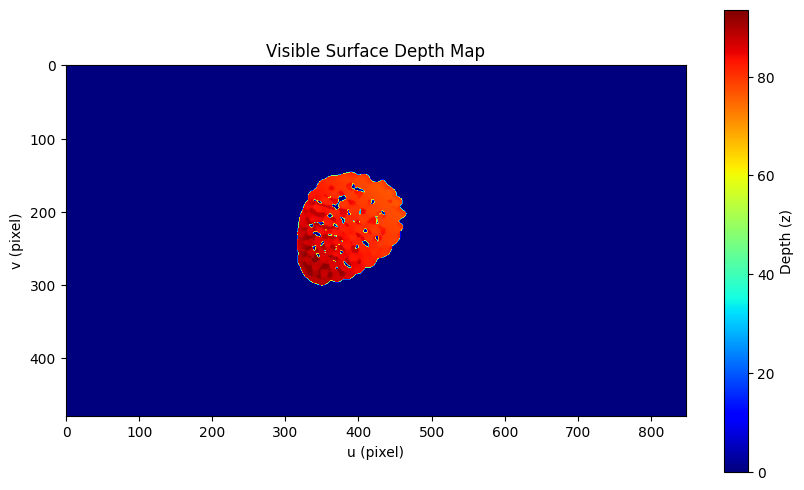

In [25]:
visible_pts, visible_indices, uv, depth_img = get_visible_surface_points(np.asarray(mesh.vertices), fx, fy, cx, cy, W, H)
visible_mesh = trimesh.points.PointCloud(visible_pts)
visible_mesh.visual.vertex_colors = [0, 255, 0, 255]
visualize_depth_image(depth_img)

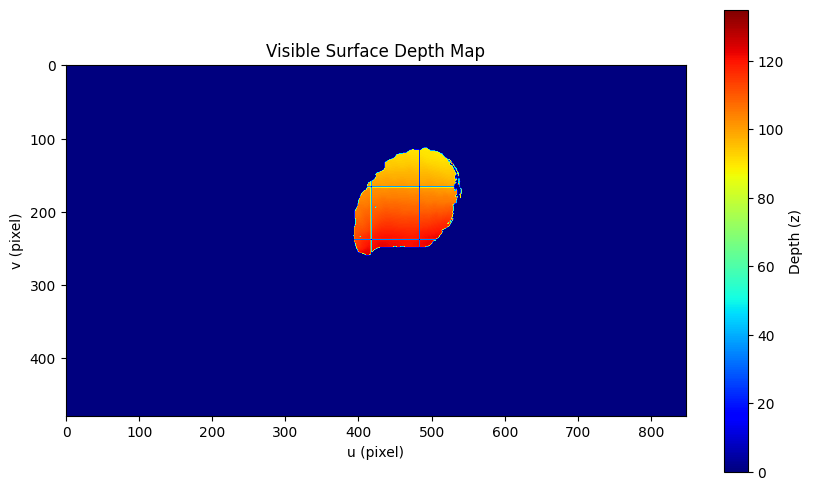

In [26]:
visible_point_cloud_pts, visible_pcd_indices, uv_pcd, depth_pcd_img = get_visible_surface_points(np.asarray(cloud.vertices), fx, fy, cx, cy, W, H)
visible_point_cloud_mesh = trimesh.points.PointCloud(visible_point_cloud_pts)
visible_point_cloud_mesh.colors = np.tile(blue, (len(visible_point_cloud_pts), 1))
visualize_depth_image(depth_pcd_img)

In [27]:
mesh_pcd_scale = cloud.extents[0] / mesh.extents[0]
scale_matrix_1 = trimesh_scale_matrix(mesh.centroid, [[mesh_pcd_scale, mesh_pcd_scale, mesh_pcd_scale]], 1)
mesh.apply_transform(scale_matrix_1)
visible_mesh.apply_transform(scale_matrix_1)

<trimesh.PointCloud(vertices.shape=(16406, 3))>

In [28]:
voxel_size = 1
# mesh_pcd = create_point_cloud(np.array(mesh.vertices))
# mesh_pcd = mesh_pcd.voxel_down_sample(voxel_size=1.5)
# mesh.vertices = np.asarray(mesh_pcd.points)

# cloud_pcd = create_point_cloud(pointclouds)
# cloud_pcd = cloud_pcd.voxel_down_sample(voxel_size=voxel_size)
# cloud.points = np.asarray(cloud_pcd.points)

visible_mesh_pcd = create_point_cloud(np.array(visible_mesh.vertices))
visible_mesh_pcd = visible_mesh_pcd.voxel_down_sample(voxel_size=voxel_size)
visible_mesh.vertices = np.asarray(visible_mesh_pcd.points)

visible_point_cloud_mesh_pcd = create_point_cloud(np.array(visible_point_cloud_mesh.vertices))
visible_point_cloud_mesh_pcd = visible_point_cloud_mesh_pcd.voxel_down_sample(voxel_size=voxel_size)
visible_point_cloud_mesh.vertices = np.asarray(visible_point_cloud_mesh_pcd.points)

In [29]:
draw_registration_result(visible_mesh, visible_point_cloud_mesh).show()

In [30]:
threshold_lis = [100, 1.25]
scale_flag_lis = [False, True]

transform_lis, aligned_mesh, scene_lis = multi_icp_loop(visible_mesh, visible_point_cloud_mesh, mesh, threshold_lis, scale_flag_lis,  num=2)
transform_lis = list(reversed(transform_lis))
for i in range(len(transform_lis)):
    T = transform_lis[i]
    T = Transform_normalization(T)
    aligned_mesh.apply_transform(np.linalg.inv(T))
aligned_mesh.apply_transform(np.linalg.inv(flip_transform))
aligned_mesh.apply_transform(np.linalg.inv(transform_matrix))
aligned_mesh.apply_translation(-aligned_mesh.centroid)  # Center the mesh at the origin

RegistrationResult with fitness=1.000000e+00, inlier_rmse=2.806425e+00, and correspondence_set size of 1831
Access transformation to get result.
Estimated transform:
 [[  0.82529283  -0.20166645   0.5274679  -79.47738997]
 [ -0.17963249   0.791789     0.58378279 -56.91024985]
 [ -0.53537268  -0.57654213   0.61723194  47.40862019]
 [  0.           0.           0.           1.        ]]
RegistrationResult with fitness=7.214637e-01, inlier_rmse=7.138217e-01, and correspondence_set size of 1321
Access transformation to get result.
Estimated transform:
 [[ 0.91357971  0.10719334 -0.09158263 12.27238929]
 [-0.11078879  0.91718597 -0.03164531  4.17820291]
 [ 0.08719882  0.04225126  0.91930239  7.94595809]
 [ 0.          0.          0.          1.        ]]


<trimesh.PointCloud(vertices.shape=(483072, 3))>

In [31]:
scene_lis[0].show()

In [32]:
scene_lis[1].show()

In [33]:
print(aligned_mesh.extents)
aligned_mesh.vertices = pcd_project(aligned_mesh.vertices)

[39.31463735 53.09802048 11.51132333]
Minimum Z value is: -6.076445155387326
X boundary is: [-19.47170507838871, 19.09651493185115]
Z boundary is: [-20.056523301901642, 27.407450749252334]


In [34]:
scene = trimesh.Scene()
scene.add_geometry(aligned_mesh)
scene.add_geometry(trimesh.creation.axis(origin_size=10, axis_length=100))
scene.show()

In [37]:
pcd = create_point_cloud(np.array(aligned_mesh.vertices))
pcd_down = pcd.voxel_down_sample(voxel_size=2)
#Find the center and translate the model to the origin
center = np.mean(np.asarray(pcd_down.points), axis=0)
pcd_down.translate(-center)
print(f'Desampled Camera Point Cloud has: {len(pcd_down.points)} points')
print(type(pcd_down.get_oriented_bounding_box().extent))

Desampled Camera Point Cloud has: 2331 points
<class 'numpy.ndarray'>


In [38]:
# Calculate the mean of mean neighbor distance and determine the radius of searching sphere in normals calculation
distance = pcd_down.compute_nearest_neighbor_distance()
avg_dist = np.mean(distance)
print(f"Average Distance is: {avg_dist}")
radius = 5 * avg_dist
print(f"Radius is: {radius}")

bbox = pcd_down.get_axis_aligned_bounding_box()
box_extension_factor = 2
new_min_bound = bbox.min_bound - np.array([box_extension_factor, box_extension_factor, box_extension_factor])
new_max_bound = bbox.max_bound + np.array([box_extension_factor, box_extension_factor, box_extension_factor])

expanded_bbox = o3d.geometry.AxisAlignedBoundingBox(min_bound=new_min_bound, max_bound=new_max_bound)

pcd_down.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=radius, max_nn=75))
pcd_down.orient_normals_consistent_tangent_plane(50)
o3d.visualization.draw_geometries([coordinate_frame(),pcd_down])

Average Distance is: 1.148558231686533
Radius is: 5.742791158432665


In [39]:
p_mesh, densities = o3d.geometry.TriangleMesh.create_from_point_cloud_poisson(pcd_down, depth=5, width=0, scale= 3, linear_fit= True)

p_mesh_crop = p_mesh.crop(expanded_bbox)

p_mesh.simplify_quadric_decimation(100)

p_mesh.remove_degenerate_triangles()
p_mesh.remove_duplicated_triangles()
p_mesh.remove_non_manifold_edges()

p_mesh.compute_triangle_normals()

print(f"Number of vertices: {len(p_mesh.vertices)}")
print(f"Number of triangles: {len(p_mesh.triangles)}")

o3d.visualization.draw_geometries([coordinate_frame(50),p_mesh])

Number of vertices: 1736
Number of triangles: 3309


In [45]:
vertices = np.asarray(p_mesh.vertices)
faces = np.asarray(p_mesh.triangles)
trimesh_mesh = trimesh.Trimesh(vertices=vertices, faces=faces)

In [46]:
trimesh_mesh.show()

In [47]:
trimesh_mesh.extents

array([51.93196487, 46.76244354, 14.25720215])

In [53]:
if p_mesh.is_watertight() is True:
    print('The generated mesh is watertight!!')
    bbox = p_mesh.get_axis_aligned_bounding_box()
    center = bbox.get_center()
    p_mesh.translate(-center)
    o3d.io.write_triangle_mesh(SAVE_PATH, p_mesh)
else:
    print('Not Watertight!!!')

The generated mesh is watertight!!
